## Loading a Fine-Tuned Detectron Model for Evaluation
In this notebook, we will load a finely tuned Detectron model and assess its performance metrics for in-depth analysis.

### Preparing and Registering Datasets for Detectron2
Important: When importing datasets from Segments, the images will be stored in the `segments` folder, and the JSON COCO annotations file will be stored in the specified `saving_path`.


In [1]:
import numpy as np
import os

# Setup detectron2 logger
from detectron2.utils.logger import setup_logger
setup_logger()


# checking the version and if we have cuda available
from src.segmentation.framework_handlers.detectron2_handler import print_version_info

!nvcc --version
print_version_info()

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Aug_15_21:14:11_PDT_2021
Cuda compilation tools, release 11.4, V11.4.120
Build cuda_11.4.r11.4/compiler.30300941_0
torch:  1.9 ; cuda:  11.1
detectron2: 0.6


In [3]:
# define the time of the training
from datetime import datetime

# Get the current date and time of the model training process
current_time = datetime.now().strftime("%d-%m-%Y_%H-%M-%S")

print(f"current time {current_time}")

current time 07-05-2024_17-00-37


Load the data used for test and eval

In [6]:
from src.segmentation.framework_handlers.detectron2_handler import prepare_and_register_datasets

dataset_name_train = "etaylor/cannabis_patches_train_26-04-2024_15-44-44"
dataset_name_test = "etaylor/cannabis_patches_test_26-04-2024_15-44-44"
release_train = "v0.1"
release_test = "v0.1"
detectron2_models_path = "/home/etaylor/code_projects/thesis/checkpoints/detectron2"

metadata_train, dataset_dicts_train, metadata_test, dataset_dicts_test = prepare_and_register_datasets(dataset_name_train, dataset_name_test, release_train, release_test)

Initializing dataset...
Preloading all samples. This may take a while...


100%|██████████| 395/395 [00:01<00:00, 283.40it/s]


Initialized dataset with 395 images.
Exporting dataset. This may take a while...


  4%|▎         | 14/395 [00:00<00:11, 32.98it/s]Skipping instance with 0 labeled pixels: IMG_0048_p7.png, instance_id: 15, category_id: 1
Skipping instance with 0 labeled pixels: IMG_0048_p8.png, instance_id: 9, category_id: 2
100%|██████████| 395/395 [00:11<00:00, 34.15it/s]


Exported to ./export_coco-instance_etaylor_cannabis_patches_train_26-04-2024_15-44-44_v0.1.json. Images in segments/etaylor_cannabis_patches_train_26-04-2024_15-44-44/v0.1
Initializing dataset...
Preloading all samples. This may take a while...


100%|██████████| 108/108 [00:00<00:00, 331.44it/s]


Initialized dataset with 108 images.
Exporting dataset. This may take a while...


100%|██████████| 108/108 [00:03<00:00, 35.32it/s]


Exported to ./export_coco-instance_etaylor_cannabis_patches_test_26-04-2024_15-44-44_v0.1.json. Images in segments/etaylor_cannabis_patches_test_26-04-2024_15-44-44/v0.1
WARNING [05/07 17:01:32 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/07 17:01:32 d2.data.datasets.coco]: Loaded 369 images in COCO format from segments/etaylor_cannabis_patches_train_26-04-2024_15-44-44/annotations/export_coco-instance_etaylor_cannabis_patches_train_26-04-2024_15-44-44_v0.1.json
WARNING [05/07 17:01:33 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/07 17:01:33 d2.data.datasets.coco]: Loaded 106 images in COCO format from segments/etaylor_cannabis_patches_test_26-04-2024_15-44-44/annotations/export_coco-instance_etaylor_cannabis_patches_test_26-04-2024_15-44-44_v0.1.json


Code for loading model checkpoint and config

In [7]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor

# load the best model config and weights
checkpoint_path = "/home/etaylor/code_projects/thesis/checkpoints/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/03-05-2024_19-23-15/model_final.pth"
config_yaml_path = "/home/etaylor/code_projects/thesis/checkpoints/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/03-05-2024_19-23-15/config.yaml"
cfg = get_cfg()
# load config
cfg.merge_from_file(config_yaml_path)

Loading config /home/etaylor/code_projects/thesis/checkpoints/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/03-05-2024_19-23-15/config.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


#### Register new test set and evaluate metrics

In [6]:
# # Register new test set
# from src.segmentation.framework_handlers.detectron2_handler import convert_segments_to_coco_format
# from detectron2.data import DatasetCatalog, MetadataCatalog
# from detectron2.data.datasets import register_coco_instances

# dataset_name_test = "etaylor/cannabis_patches_week9_15_06_2023_3x_regular_IMG_2285"
# release_test = "v0.2"

# # Convert segments dataset to coco format for testing dataset
# _, test_export_json_path, test_saved_images_path = convert_segments_to_coco_format(
#     dataset_name=dataset_name_test, 
#     release_version=release_test, 
# )

# register_coco_instances(dataset_name_test, {}, test_export_json_path, test_saved_images_path)

# metadata_test = MetadataCatalog.get(dataset_name_test)
# dataset_dicts_test = DatasetCatalog.get(dataset_name_test)

Initializing dataset...
Preloading all samples. This may take a while...


100%|██████████| 15/15 [00:00<00:00, 57.88it/s]


Initialized dataset with 15 images.
Exporting dataset. This may take a while...


100%|██████████| 15/15 [00:00<00:00, 19.48it/s]

Exported to ./export_coco-instance_etaylor_cannabis_patches_week9_15_06_2023_3x_regular_IMG_2285_v0.2.json. Images in segments/etaylor_cannabis_patches_week9_15_06_2023_3x_regular_IMG_2285/v0.2
WARNING [04/06 15:10:06 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[04/06 15:10:06 d2.data.datasets.coco]: Loaded 15 images in COCO format from segments/etaylor_cannabis_patches_week9_15_06_2023_3x_regular_IMG_2285/annotations/export_coco-instance_etaylor_cannabis_patches_week9_15_06_2023_3x_regular_IMG_2285_v0.2.json


In [10]:
# define predictor
cfg.MODEL.WEIGHTS = checkpoint_path
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
predictor = DefaultPredictor(cfg)

[05/07 17:03:20 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /home/etaylor/code_projects/thesis/checkpoints/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/03-05-2024_19-23-15/model_final.pth ...


Evaluate the performance of the trained model on the test dataset using the `COCOEvaluator`

In [19]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
import json

evaluator = COCOEvaluator(dataset_name_test, 
                        output_dir=os.path.join(cfg.OUTPUT_DIR, dataset_name_test), 
                        max_dets_per_image=1000,
                        use_fast_impl=True)
val_loader = build_detection_test_loader(cfg, dataset_name_test)
eval_results = inference_on_dataset(predictor.model, val_loader, evaluator)

# Check if the directory exists
output_dir = os.path.join(cfg.OUTPUT_DIR, os.path.basename(dataset_name_test))
if not os.path.exists(output_dir):
    os.mkdir(output_dir)
    
# eval_results_saving_path = os.path.join(cfg.OUTPUT_DIR, os.path.basename(dataset_name_test), "evaluation_results.json")
# # Save the eval_results dictionary to a JSON file
# with open(eval_results_saving_path, 'w') as file:
#     json.dump(eval_results, file, indent=4)

WARNING [05/07 17:30:02 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/07 17:30:02 d2.data.datasets.coco]: Loaded 106 images in COCO format from segments/etaylor_cannabis_patches_test_26-04-2024_15-44-44/annotations/export_coco-instance_etaylor_cannabis_patches_test_26-04-2024_15-44-44_v0.1.json
[05/07 17:30:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/07 17:30:03 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/07 17:30:03 d2.data.common]: Serializing 106 elements to byte tensors and concatenating them all ...
[05/07 17:30:03 d2.data.common]: Serialized dataset takes 0.22 MiB
[05/07 17:30:03 d2.evaluation.evaluator]: Start inference on 106 batches


[05/07 17:30:04 d2.evaluation.evaluator]: Inference done 11/106. Dataloading: 0.0012 s/iter. Inference: 0.1046 s/iter. Eval: 0.0077 s/iter. Total: 0.1135 s/iter. ETA=0:00:10
[05/07 17:30:09 d2.evaluation.evaluator]: Inference done 54/106. Dataloading: 0.0014 s/iter. Inference: 0.1071 s/iter. Eval: 0.0093 s/iter. Total: 0.1178 s/iter. ETA=0:00:06
[05/07 17:30:14 d2.evaluation.evaluator]: Inference done 97/106. Dataloading: 0.0014 s/iter. Inference: 0.1078 s/iter. Eval: 0.0081 s/iter. Total: 0.1174 s/iter. ETA=0:00:01
[05/07 17:30:15 d2.evaluation.evaluator]: Total inference time: 0:00:11.890728 (0.117730 s / iter per device, on 1 devices)
[05/07 17:30:15 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:10 (0.107532 s / iter per device, on 1 devices)
[05/07 17:30:15 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/07 17:30:15 d2.evaluation.coco_evaluation]: Saving results to /home/etaylor/code_projects/thesis/checkpoints/detectron2/COCO-InstanceS

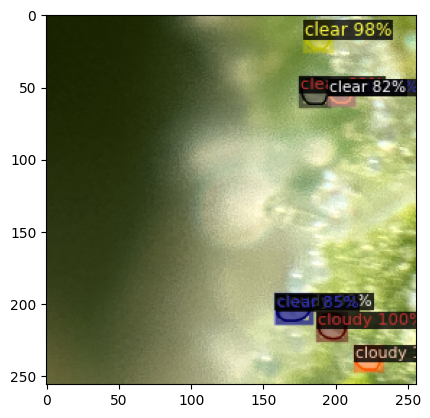

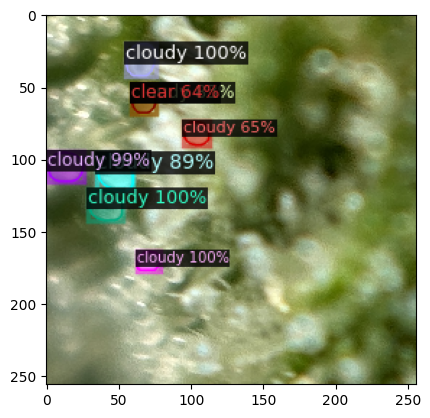

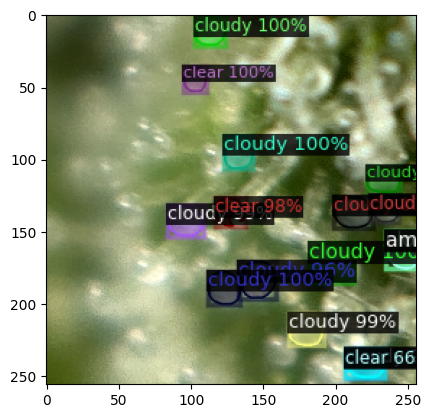

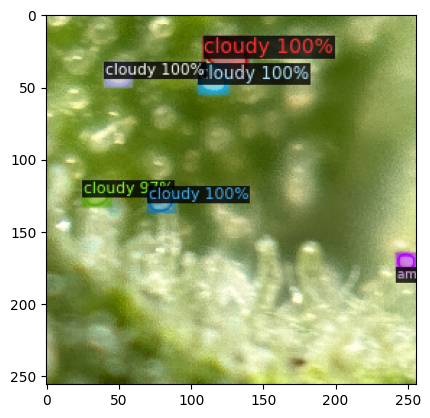

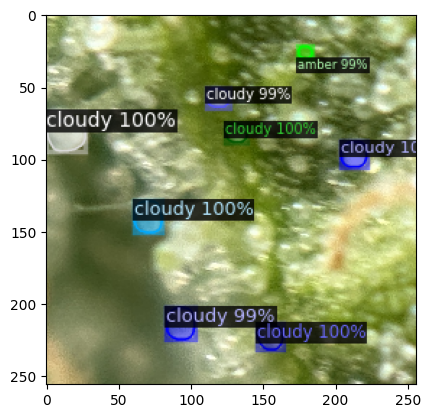

...

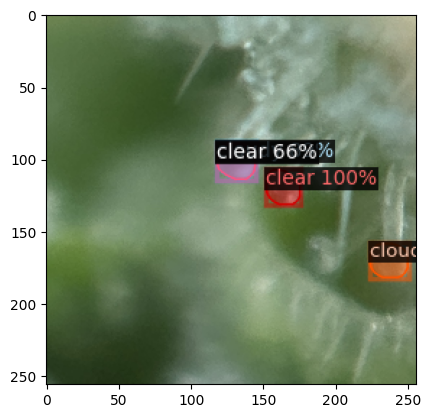

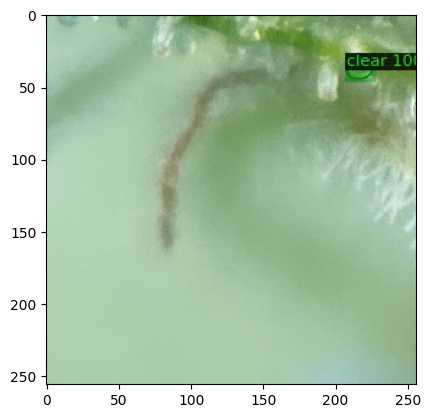

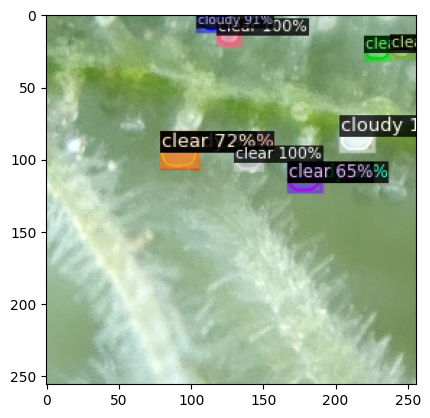

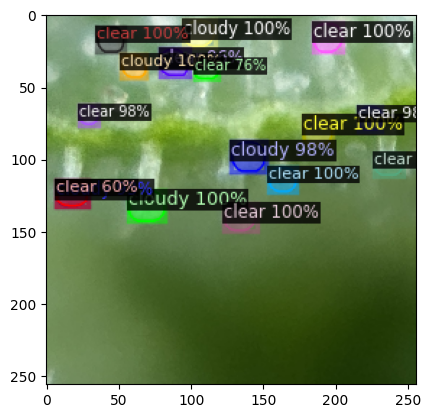

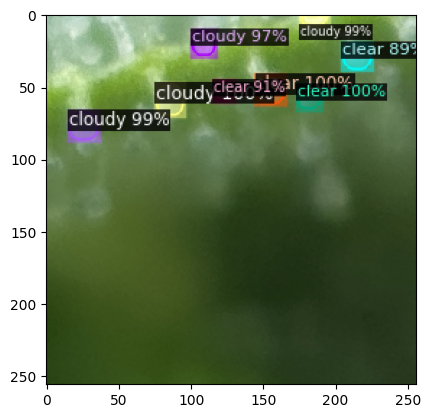

In [12]:
from src.segmentation.framework_handlers.detectron2_handler import plot_test_predictions

plot_test_predictions(dataset_dicts_test, metadata_test, predictor)

In [ ]:
# define predictor
cfg.MODEL.WEIGHTS = checkpoint_path
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7 
predictor = DefaultPredictor(cfg)

In [16]:
# calculate the results for each confidence threshold and compare the results
thresholds = np.arange(0.1, 1.0, 0.05)
results = {}
for threshold in thresholds:
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = float(threshold)
    predictor = DefaultPredictor(cfg)
    evaluator = COCOEvaluator(dataset_name_test, output_dir=os.path.join(cfg.OUTPUT_DIR, dataset_name_test))
    val_loader = build_detection_test_loader(cfg, dataset_name_test)
    eval_results = inference_on_dataset(predictor.model, val_loader, evaluator)
    results[str(threshold)]= eval_results

[05/05 18:14:18 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /home/etaylor/code_projects/thesis/checkpoints/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/03-05-2024_19-23-15/model_final.pth ...
WARNING [05/05 18:14:18 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/05 18:14:18 d2.data.datasets.coco]: Loaded 106 images in COCO format from segments/etaylor_cannabis_patches_test_26-04-2024_15-44-44/annotations/export_coco-instance_etaylor_cannabis_patches_test_26-04-2024_15-44-44_v0.1.json
[05/05 18:14:18 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/05 18:14:18 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/05 18:14:18 d2.data.common]: Serializing 106 elements to byte tensors and concatenating 

In [17]:
results

{'0.1': OrderedDict([('bbox',
               {'AP': 33.533939220454116,
                'AP50': 46.79420455526665,
                'AP75': 39.48091503131481,
                'APs': 33.102488378021555,
                'APm': 36.26114705777198,
                'APl': nan,
                'AP-trichome': nan,
                'AP-clear': 33.51389491241893,
                'AP-cloudy': 47.55255038400037,
                'AP-amber': 19.535372364943033}),
              ('segm',
               {'AP': 33.40827847852828,
                'AP50': 45.673424692009824,
                'AP75': 39.8204207194829,
                'APs': 28.737675250740747,
                'APm': 38.398576578798746,
                'APl': nan,
                'AP-trichome': nan,
                'AP-clear': 33.050231204244504,
                'AP-cloudy': 46.81251312046357,
                'AP-amber': 20.362091110876772})]),
 '0.15000000000000002': OrderedDict([('bbox',
               {'AP': 33.12482704541886,
             

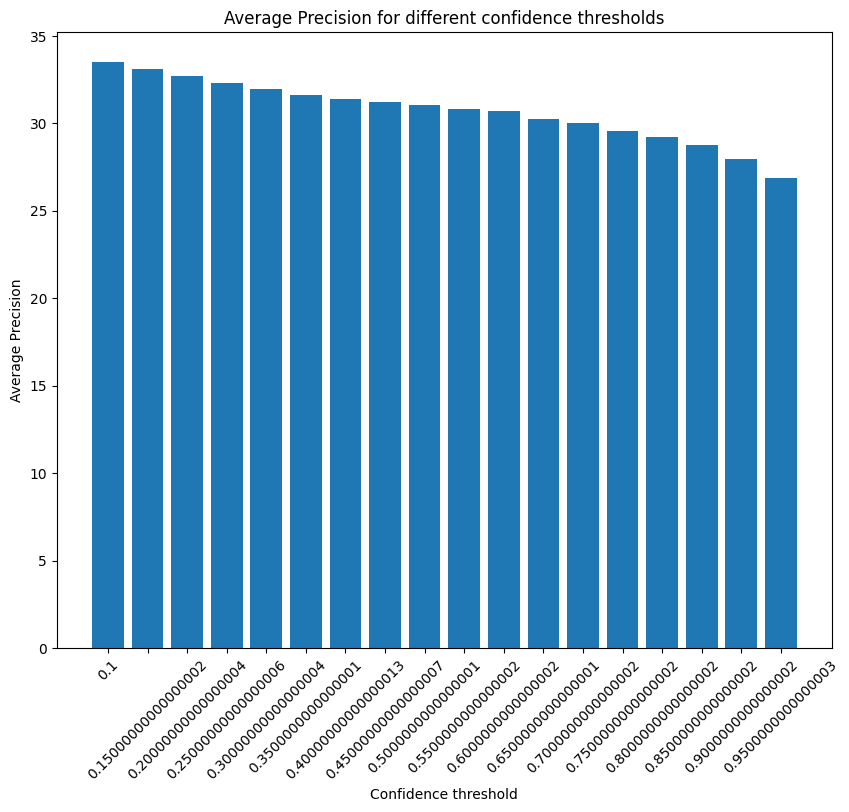

In [18]:
# create barplot comparing the result of the thresholds
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
ax.bar(results.keys(), [result['bbox']['AP'] for result in results.values()])
# set size of plot
fig.set_size_inches(10, 8)
ax.set_xlabel('Confidence threshold')
ax.set_ylabel('Average Precision')
#rotate x axis by 45 degrees
plt.xticks(rotation=45)
ax.set_title('Average Precision for different confidence thresholds')
plt.show()


Plot model predictions on test set

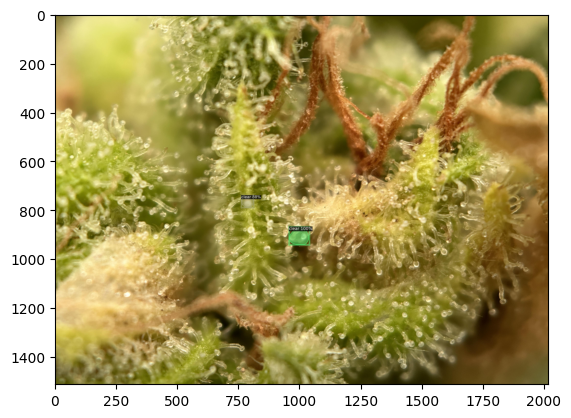

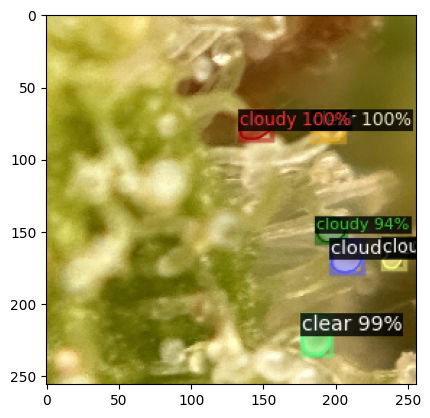

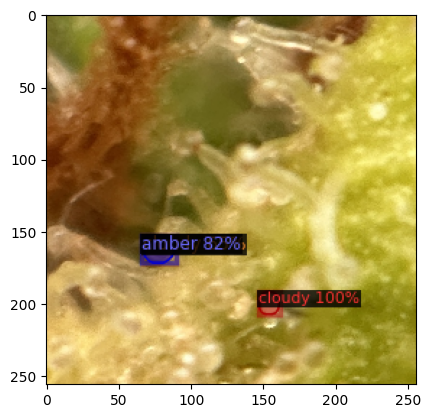

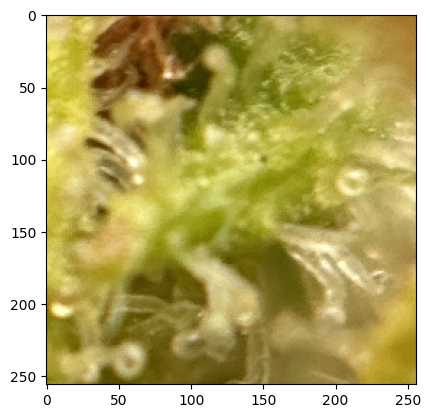

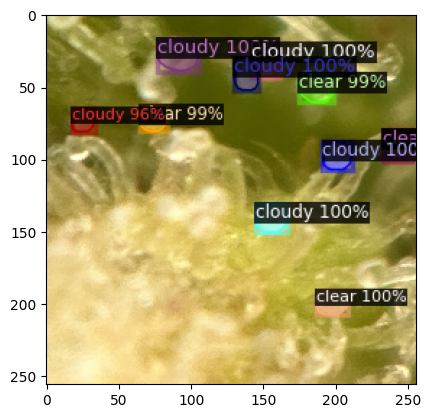

...

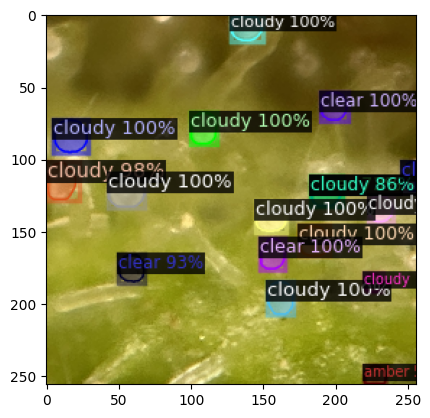

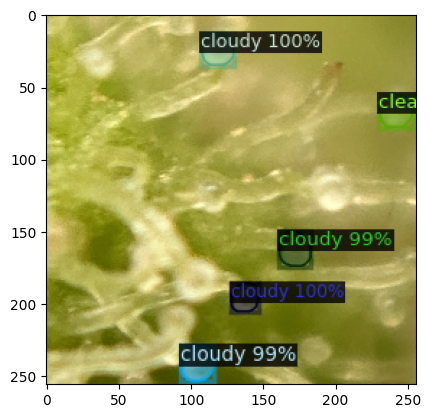

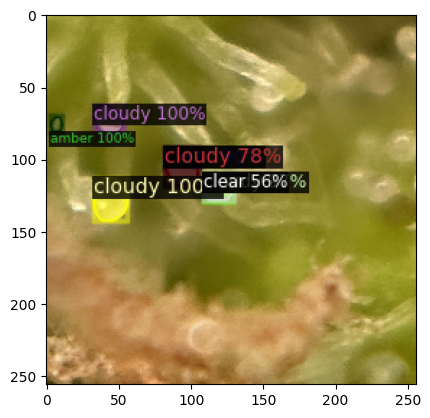

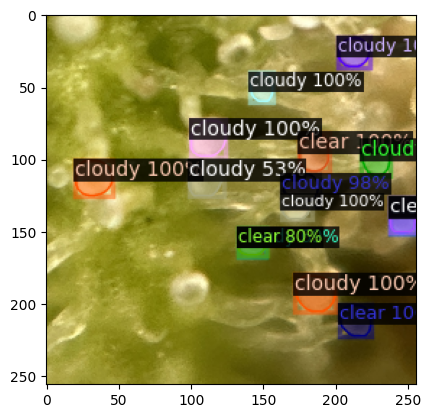

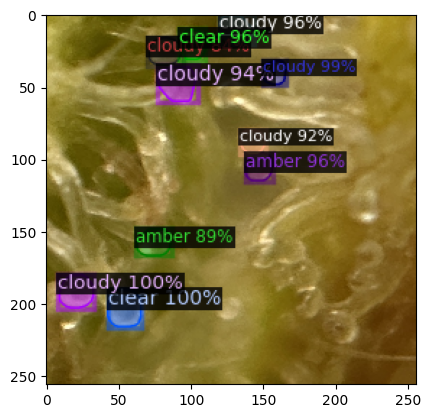

In [8]:
from src.segmentation.framework_handlers.detectron2_handler import plot_test_predictions

plot_test_predictions(dataset_dicts_test, metadata_test, predictor)

In [ ]:
# TODO: encapsulate the statistics calculations for the predictions to a function
# TODO:start saving evaluation results and compare with different models and hyper params

#### Segment images and save object level information into a csv file.



In [11]:
from src.segmentation.framework_handlers.detectron2_handler import extract_object_info_to_csv

dataset_directory = "/home/etaylor/code_projects/thesis/segments/etaylor_cannabis_patches_week8_07_06_2023_3x_regular_IMG_1753" 
input_images_directory = os.path.join(dataset_directory, "v0.1")
csv_file_name = "detected_objects.csv"
output_csv_path = os.path.join(dataset_directory,csv_file_name)

extract_object_info_to_csv(input_images_directory, output_csv_path, predictor, metadata_train)

'Object-level information saved to CSV file at /home/etaylor/code_projects/thesis/segments/etaylor_cannabis_patches_week8_07_06_2023_3x_regular_IMG_1753/detected_objects.csv'

In [ ]:
from src.segmentation.framework_handlers.detectron2_handler import plot_class_statistics

plot_class_statistics(output_csv_path, metadata_train)

/tmp/ipykernel_24632/3811209441.py:19: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="Class Name", y="Object Number", data=avg_objects_per_class, ci=None, order=class_names)


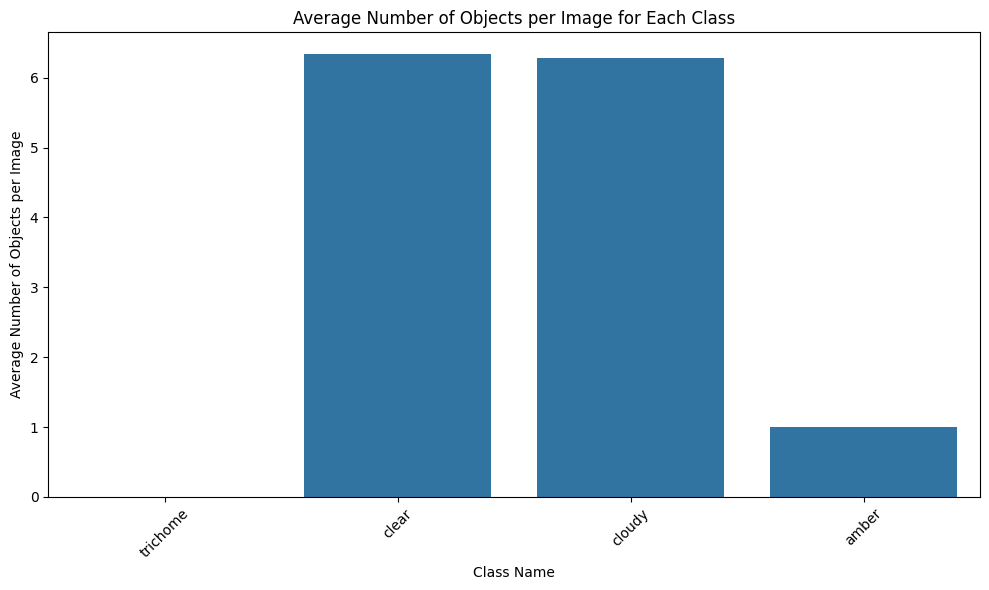

/tmp/ipykernel_24632/3811209441.py:33: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="Class Name", y="Area", data=avg_area_per_class, ci=None, order=class_names)


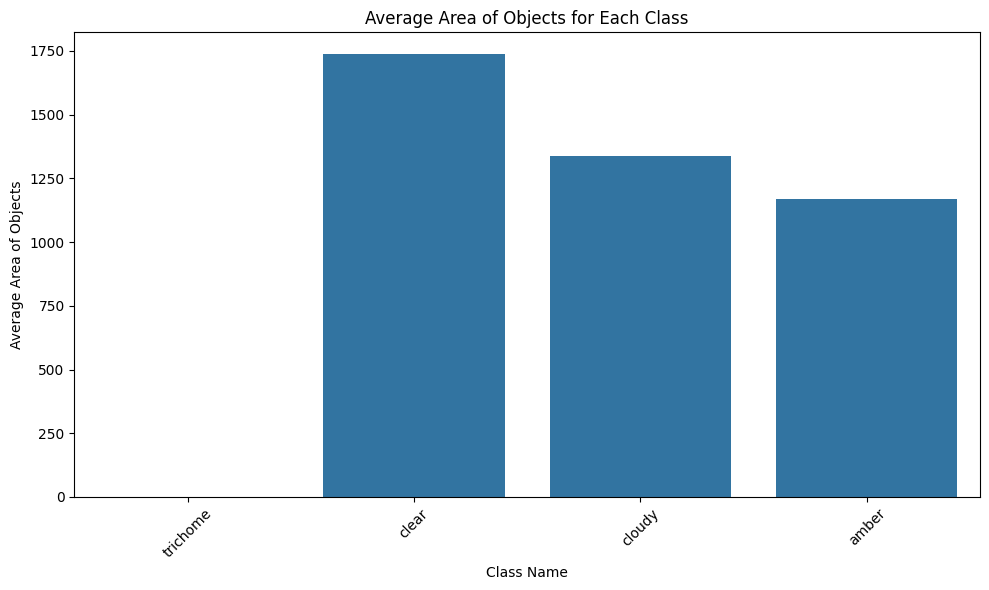

In [12]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the CSV file into a pandas DataFrame
df = pd.read_csv(output_csv_path)

# Get class names from train_metadata.thing_classes
class_names = metadata_train.thing_classes

# Group the data by both "File Name" and "Class Name" and calculate the average number of objects per image for each class
# first group the data by both "File Name" and "Class Name" and count the number of objects within each group.
#Then, group the data by "Class Name" only and calculate the mean of the counts, which gives us the average number of objects per image for each class.
avg_objects_per_class = df.groupby(["File Name", "Class Name"])["Object Number"].count().reset_index()
avg_objects_per_class = avg_objects_per_class.groupby("Class Name")["Object Number"].mean().reset_index()

# Plot: Average number of objects per image for each class
plt.figure(figsize=(10, 6))
sns.barplot(x="Class Name", y="Object Number", data=avg_objects_per_class, ci=None, order=class_names)
plt.xticks(rotation=45)
plt.xlabel("Class Name")
plt.ylabel("Average Number of Objects per Image")
plt.title("Average Number of Objects per Image for Each Class")
plt.tight_layout()
plt.show()


# Group the data by class and calculate the average area of objects for each class
avg_area_per_class = df.groupby("Class Name")["Area"].mean().reset_index()

# Plot: Average area of objects for each class
plt.figure(figsize=(10, 6))
sns.barplot(x="Class Name", y="Area", data=avg_area_per_class, ci=None, order=class_names)
plt.xticks(rotation=45)
plt.xlabel("Class Name")
plt.ylabel("Average Area of Objects")
plt.title("Average Area of Objects for Each Class")
plt.tight_layout()
plt.show()
